# Find Similar Genes
author: Andrew E. Davidson, aedavids@ucsc.edu

Once we have trained a Low Rank Matrix Factorization model, we expect genes that are similar to be closer together. Keep in mind, we know how many features where learned. We do not know what they mean.

graphs
- UMAP scatter plot of Gene Low Rank Matrix Nearest Neighbors
- Gene Low Rank Matrix Nearest Neigbors Louvain Clustering
- Lovain on geneDependencies
- UMAP scatter plot of Gene Dependencies

In [1]:
import logging
from   setupLogging import setupLogging
configFilePath = setupLogging( default_path='src/test/logging.test.ini.json')
logger = logging.getLogger("notebook")
logger.info("using logging configuration file:{}".format(configFilePath))

from   DEMETER2.lowRankMatrixFactorizationEasyOfUse \
            import LowRankMatrixFactorizationEasyOfUse as LrmfEoU

import igraph as ig
import louvain
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors
import seaborn as sns
import umap

[INFO <ipython-input-1-dbbeabfaed92>:5 - <module>()] using logging configuration file:src/test/logging.test.ini.json


In [2]:
dataDir = "data/"
dataFileName = "D2_Achilles_gene_dep_scores.tsv"
numFeatures = 19
geneFilterPercent = 0.25 
holdOutPercent = 0.40 
easyOfUse = LrmfEoU(dataDir, dataFileName, numFeatures, geneFilterPercent, holdOutPercent)

In [3]:
resultsDict = easyOfUse.loadAll()

In [4]:
# clean tidy version of demeter data
Y, R, cellLinesNames, geneNames, = resultsDict["DEMETER2"]
geneDependencies = Y
print("geneDependencies.shape:{}".format(geneDependencies.shape))

# trained model
# scipy.optimize.OptimizeResult
X, Theta, optimizeResult = resultsDict["LowRankMatrixFactorizationModel"]
genes = X
print("genes.shape:{}".format(genes.shape))
cellLines = Theta
print("cellLines.shape:{}".format(cellLines.shape))

# knockout logical filters. Use to select Y Train, Validations, and Test values
RTrain, RValidation, RTest = resultsDict["filters"]

geneDependencies.shape:(11193, 501)
genes.shape:(11193, 19)
cellLines.shape:(501, 19)


# Gene Low Rank Matrix Nearest Neighbors

In [5]:
k = 4
geneNbrs = NearestNeighbors(n_neighbors=k, algorithm='brute').fit(genes)
geneDistances, geneIndices = geneNbrs.kneighbors(genes)
geneConnectivityGraph = geneNbrs.kneighbors_graph(genes).toarray()

In [6]:
print("geneDistances.shape:{}".format(geneDistances.shape))
print("geneDistances[0:{},:]:\n{}".format(k, geneDistances[0:k,:]))
print()
print("geneIndices.shape:{}".format(geneIndices.shape))
print("geneIndices[0:{},:]:\n{}".format(k, geneIndices[0:k,:]))
print()
# sanity check you are always closest to your self. Look for Identity matrix + other stuff
print("geneConnectivityGraph[0:{}, 0:{}]:\n{}".format(k, k, geneConnectivityGraph[0:k, 0:k]))

geneDistances.shape:(11193, 4)
geneDistances[0:4,:]:
[[0.         0.12600302 0.13149575 0.13592837]
 [0.         0.14574433 0.15497985 0.15855747]
 [0.         0.13298643 0.14177876 0.14553515]
 [0.         0.13018807 0.14971875 0.15790533]]

geneIndices.shape:(11193, 4)
geneIndices[0:4,:]:
[[    0 10261   744  1311]
 [    1  9545  4941  4394]
 [    2   458  5541  1402]
 [    3  9963  3161  5897]]

geneConnectivityGraph[0:4, 0:4]:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


## Descriptive distance stats

In [7]:
nnGeneDF = pd.DataFrame(data=geneDistances)
nnGeneDF.head()

,0,1,2,3
0,0.0,0.126003,0.131496,0.135928
1,0.0,0.145744,0.154980,0.158557
2,0.0,0.132986,0.141779,0.145535
3,0.0,0.130188,0.149719,0.157905
4,0.0,0.116052,0.136164,0.144557


In [8]:
nnGeneDF.describe()

,0,1,2,3
count,11193.0,11193.000000,11193.000000,11193.000000
mean,0.0,0.155882,0.165174,0.170140
std,0.0,0.046549,0.048187,0.049324
min,0.0,0.051070,0.087659,0.095070
25%,0.0,0.126255,0.134725,0.139173
50%,0.0,0.145253,0.153409,0.158062
75%,0.0,0.171350,0.179930,0.185197
max,0.0,0.792189,0.797687,0.817134


## Find similar genes
TODO: AEDWIP: FIXME:
            
I copied this code into the find similar cell line notebook. refactor into python and create a unit test

In [9]:
def findNearestGenes(geneNames, distances, indices, closestN=5):
    '''
    genes that are cloest, nearest, should be more similar
    
    example:
        geneNbrs = NearestNeighbors(n_neighbors=k, algorithm='brute').fit(genes)
        geneDistances, geneIndices = geneNbrs.kneighbors(genes)
    
    arguments:
        distances:
            a 2 d numpy array 
            
        indices
        
    returns 
        (names, smallestDistanceIdxList distance)
            name: 
                a list of tuples of gene names pairs that are close
                
            smallestDistanceIdxList: 
                a list of tuples. values are index into distances matrix
                
            distance, the distance between genes
                
    '''
    cols = 0
    sortedIdx = np.argsort(distances[:,1], axis=cols)
    smallestDistanceIdxList = [ (i, indices[i,1]) for i in sortedIdx[0:closestN] ]
    names = [ (geneNames[i], geneNames[j])  for i,j in smallestDistanceIdxList ]
    distValues = [ distances[i,1] for i in sortedIdx[0:closestN]]

    return (names, smallestDistanceIdxList, distValues)

def testFindNearestGenes() :
    """
    assumes we have loaded Low Rank Matrix Factorization Model trained as follows
        dataDir = "data/"
        dataFileName = "D2_Achilles_gene_dep_scores.tsv"
        numFeatures = 19
        geneFilterPercent = 0.25 
        holdOutPercent = 0.40 
    """
    distances = geneDistances[0:3,:]
    indices = geneIndices[0:3,:]
    result = findNearestGenes(geneNames, distances, indices, closestN=3)
    names, smallestDistanceIdxList, distValues = result
    print("\n names:\n{}".format(names))
    print("\n smallestDistanceIdxList:\n{}".format(smallestDistanceIdxList))
    print("\n distValues:\n{}".format(distValues))
    
    expNames = [('"A1BG (1)"', '"TNFSF14 (8740)"'), ('"ADA (100)"', '"ARIH2 (10425)"'), ('"NAT2 (10)"', '"GDPD5 (81544)"')]
    expIdx = [(0, 10261), (2, 458), (1, 9545)]
    expDis = [0.1260030197338764, 0.13298643043752775, 0.14574432921786282]
    
    assert names == expNames
    assert smallestDistanceIdxList == expIdx
    assert distValues == expDis
    
testFindNearestGenes()


 names:
[('"A1BG (1)"', '"TNFSF14 (8740)"'), ('"ADA (100)"', '"ARIH2 (10425)"'), ('"NAT2 (10)"', '"GDPD5 (81544)"')]

 smallestDistanceIdxList:
[(0, 10261), (2, 458), (1, 9545)]

 distValues:
[0.1260030197338764, 0.13298643043752775, 0.14574432921786282]


In [10]:
result = findNearestGenes(geneNames, geneDistances, geneIndices, closestN=25)
similarGenes, smallestDistanceIdxList, distValues = result
print("similar genes:\n{}".format(similarGenes))
print("\n distances:\n{}".format(distValues))

similar genes:
[('"RGPD3 (653489)"', '"RGPD2 (729857)"'), ('"RGPD2 (729857)"', '"RGPD3 (653489)"'), ('"EGR2 (1959)"', '"WEE2-AS1 (285962)"'), ('"WEE2-AS1 (285962)"', '"EGR2 (1959)"'), ('"STAT4 (6775)"', '"SLCO3A1 (28232)"'), ('"SLCO3A1 (28232)"', '"STAT4 (6775)"'), ('"TOP1MT (116447)"', '"GK (2710)"'), ('"GK (2710)"', '"TOP1MT (116447)"'), ('"SCNN1D (6339)"', '"P4HA2 (8974)"'), ('"P4HA2 (8974)"', '"SCNN1D (6339)"'), ('"GTF3C5 (9328)"', '"B3GNT4 (79369)"'), ('"B3GNT4 (79369)"', '"GTF3C5 (9328)"'), ('"CHKB (1120)"', '"TNFRSF13B (23495)"'), ('"TNFRSF13B (23495)"', '"CHKB (1120)"'), ('"SLC30A4 (7782)"', '"DIEXF (27042)"'), ('"DIEXF (27042)"', '"SLC30A4 (7782)"'), ('"PRLR (5618)"', '"CPOX (1371)"'), ('"CPOX (1371)"', '"PRLR (5618)"'), ('"SLC9A5 (6553)"', '"USP2 (9099)"'), ('"USP2 (9099)"', '"SLC9A5 (6553)"'), ('"DKK4 (27121)"', '"NDUFAF1 (51103)"'), ('"NDUFAF1 (51103)"', '"DKK4 (27121)"'), ('"ZNF611 (81856)"', '"TNFRSF6B (8771)"'), ('"TNFRSF6B (8771)"', '"ZNF611 (81856)"'), ('"PPM1E (22843)

## UMAP scatter plot of Gene Low Rank Matrix Nearest Neighbors

In [11]:
nnReducer = umap.UMAP()
nnEmbedding = nnReducer.fit_transform(geneDistances)
print("nnEmbedding.shape:{}".format(nnEmbedding.shape))

/Users/andrewdavidson/anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/Users/andrewdavidson/anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel

nnEmbedding.shape:(11193, 2)


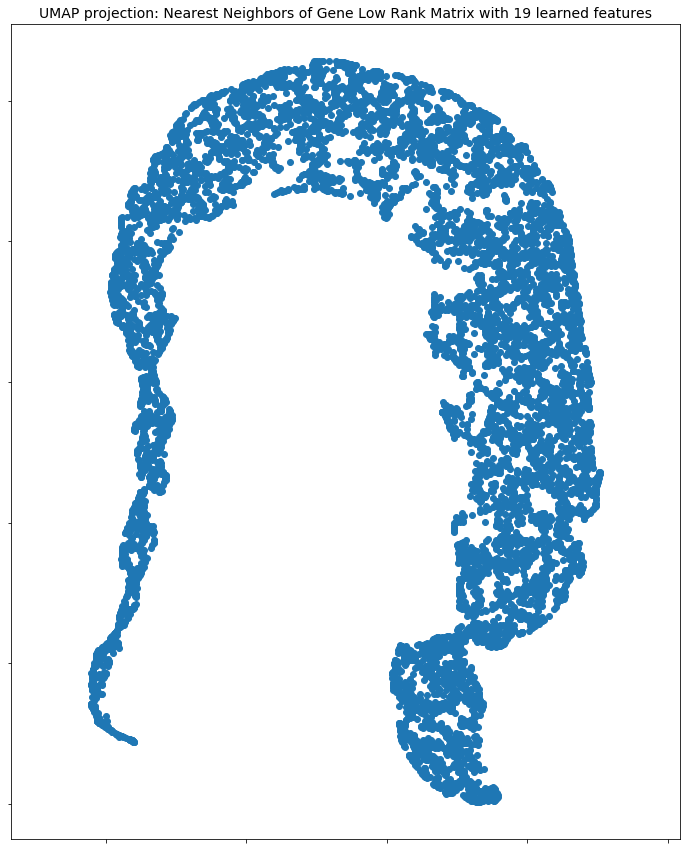

In [12]:
#, c=[sns.color_palette()[x] for x in geneEmbedding.target]
fig= plt.figure(figsize=(12,15))
ax = plt.gca()

plt.scatter(nnEmbedding[:, 0], nnEmbedding[:, 1])
ax.set_aspect('equal', 'datalim')

plt.title('UMAP projection: Nearest Neighbors of Gene Low Rank Matrix with 19 learned features', fontsize=14);

# Turn off tick labels
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show
fig.savefig('imgs/UMAP_nearestNeighborsGenes_LMRF19.pdf')

# UMAP scatter plot of Gene Low Rank Matrix

In [30]:
genes_nnReducer = umap.UMAP()
genes_nnEmbedding = genes_nnReducer.fit_transform(genes)
print("genes_nnEmbedding.shape:{}".format(genes_nnEmbedding.shape))

/Users/andrewdavidson/anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


genes_nnEmbedding.shape:(11193, 2)


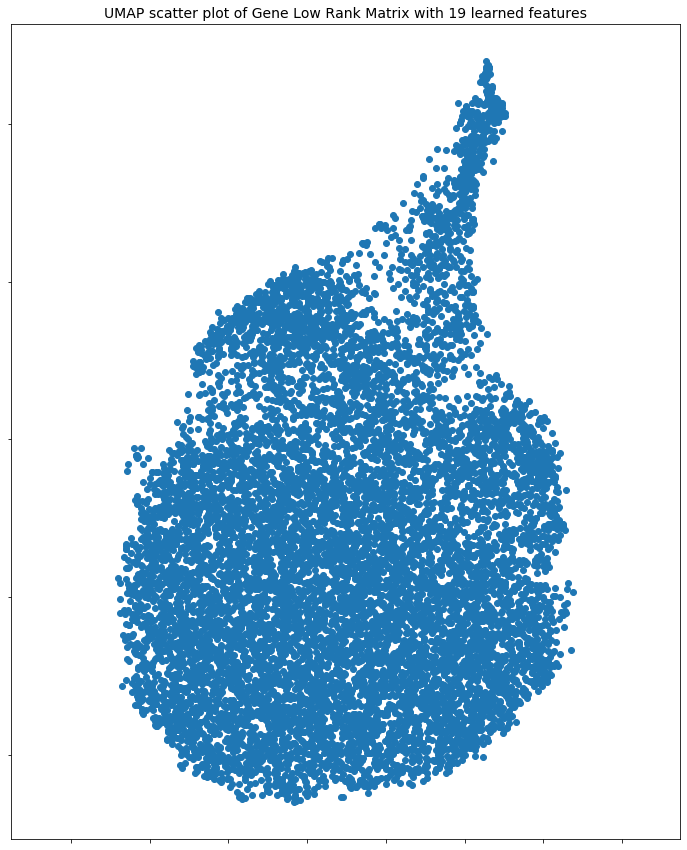

In [32]:
#, c=[sns.color_palette()[x] for x in geneEmbedding.target]
fig= plt.figure(figsize=(12,15))
ax = plt.gca()
plt.scatter(genes_nnEmbedding[:, 0], genes_nnEmbedding[:, 1])
ax.set_aspect('equal', 'datalim')

plt.title('UMAP scatter plot of Gene Low Rank Matrix with 19 learned features', fontsize=14);

# Turn off tick labels
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show
fig.savefig('imgs/UMAP_Genes_LMRF19.pdf')

## Gene  Low Rank Matrix Nearest Neigbors  Louvain Clustering
- [https://louvain-igraph.readthedocs.io/en/latest/](https://louvain-igraph.readthedocs.io/en/latest/)
- [https://igraph.org/python/doc/tutorial/tutorial.html](https://igraph.org/python/doc/tutorial/tutorial.html)

In [13]:
# create a graph
geneGraph = ig.Graph()

# add vertices
numVertices = geneDistances.shape[0]
geneGraph.add_vertices(numVertices)

# add edges
for i in range(numVertices):
    idx = geneIndices[i,1:]
    edges = [ (i, j) for j in idx ]
    geneGraph.add_edges( edges )

In [14]:
genePartition = louvain.find_partition(geneGraph, louvain.ModularityVertexPartition);
aedwip what kind of infor can we get out of genePartition?  number of communities?

Object `communities` not found.


In [15]:
print(type(genePartition))

<class 'louvain.VertexPartition.ModularityVertexPartition'>


In [16]:
# you can save or display but not both
# only png format is supported
#
# genePlotOut = ig.plot(genePartition) 
# genePlotOut.save("imgs/louvain_Nearest_Neigbors_gene_19.png")

ig.plot(genePartition) 

# Lovain on geneDependencies
One way to evaluate our Low Rank Matrix Factorization Model is to compare it to other compare results obtained when we do not create an embedding. That is to say we use the original data

In [17]:
geneDepNbrs = NearestNeighbors(n_neighbors=k, algorithm='brute').fit(geneDependencies)
genDepDistances, geneDepIndices = geneDepNbrs.kneighbors(geneDependencies)
genDepConnectivityGraph = geneDepNbrs.kneighbors_graph(geneDependencies).toarray()

In [18]:
print("genDepDistances.shape:{}".format(genDepDistances.shape))
print("genDepDistances[0:{},:]:\n{}".format(k, genDepDistances[0:k,:]))
print()
print("geneDepIndices.shape:{}".format(geneDepIndices.shape))
print("geneDepIndices[0:{},:]:\n{}".format(k, geneDepIndices[0:k,:]))
print()
# sanity check you are always closest to your self. Look for Identity matrix + other stuff
print("genDepConnectivityGraph[0:{}, 0:{}]:\n{}".format(k, k, genDepConnectivityGraph[0:k, 0:k]))

genDepDistances.shape:(11193, 4)
genDepDistances[0:4,:]:
[[0.         3.34792952 3.40458637 3.41563565]
 [0.         3.28853047 3.36516387 3.38186874]
 [0.         3.6496408  3.67586197 3.69287948]
 [0.         3.22882927 3.28038096 3.33624873]]

geneDepIndices.shape:(11193, 4)
geneDepIndices[0:4,:]:
[[   0 4480 5290 9313]
 [   1 3018 4650  141]
 [   2  545  116 1145]
 [   3 1145  152  116]]

genDepConnectivityGraph[0:4, 0:4]:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]


In [19]:
geneDepNNDF = pd.DataFrame(data=genDepDistances)
geneDepNNDF.head()

,0,1,2,3
0,0.0,3.347930,3.404586,3.415636
1,0.0,3.288530,3.365164,3.381869
2,0.0,3.649641,3.675862,3.692879
3,0.0,3.228829,3.280381,3.336249
4,0.0,2.955009,3.081457,3.089090


In [20]:
geneDepNNDF.describe()

,0,1,2,3
count,11193.0,11193.000000,11193.000000,11193.000000
mean,0.0,3.378665,3.450408,3.488730
std,0.0,0.680878,0.693744,0.702188
min,0.0,0.000000,0.000000,0.000000
25%,0.0,2.999380,3.065008,3.101981
50%,0.0,3.244423,3.308068,3.341750
75%,0.0,3.576293,3.638656,3.672101
max,0.0,9.572718,9.734416,10.461069


In [21]:
# create a graph
geneDepGraph = ig.Graph()

# add vertices
numVertices = genDepDistances.shape[0]
geneDepGraph.add_vertices(numVertices)

# add edges
for i in range(numVertices):
    idx = geneDepIndices[i,1:]
    edges = [ (i, j) for j in idx ]
    geneDepGraph.add_edges( edges )

In [22]:
geneDepPartition = louvain.find_partition(geneDepGraph, louvain.ModularityVertexPartition);

how many cluster?

did it find the cell lines? disease type? other?

In [23]:
# https://pymotw.com/2/inspect/
import inspect

aedwip = inspect.getmembers(geneDepPartition)
print(type(aedwip))

# for name, data in aedwip:
#     if name == '__builtins__':
#         continue
#     print("{} : {}".format(name, data))


<class 'list'>


In [24]:
# you can save or display but not both
# only png format is supported
#
# geneDepPlotOut = ig.plot(geneDepPartition) 
# geneDepPlotOut.save("imgs/louvain_geneDependecies.png")

ig.plot(geneDepPartition) 

# UMAP scatter plot of Gene Dependencies

In [25]:
genDepReducer = umap.UMAP()
genDepEmbedding = nnReducer.fit_transform(geneDependencies)
print("genDepEmbedding.shape:{}".format(genDepEmbedding.shape))

/Users/andrewdavidson/anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
/Users/andrewdavidson/anaconda3/envs/labRotation3TensorFlow/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


genDepEmbedding.shape:(11193, 2)


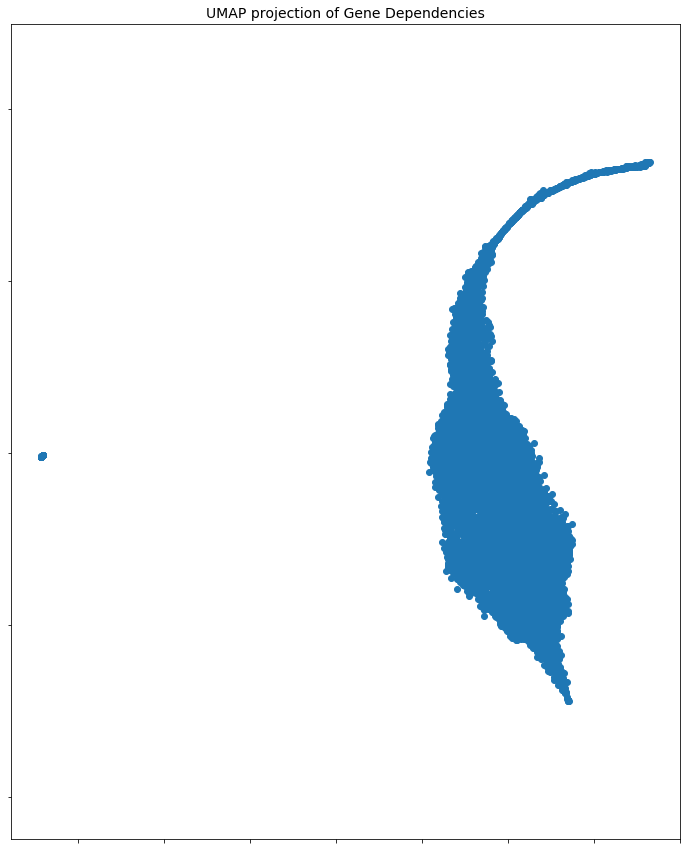

In [27]:
#, c=[sns.color_palette()[x] for x in geneEmbedding.target]
fig= plt.figure(figsize=(12,15))
ax = plt.gca()

plt.scatter(genDepEmbedding[:, 0], genDepEmbedding[:, 1])
ax.set_aspect('equal', 'datalim')

plt.title('UMAP projection of Gene Dependencies', fontsize=14);

# Turn off tick labels
ax.set_yticklabels([])
ax.set_xticklabels([])
plt.show
fig.savefig('imgs/UMAP_geneDependencies.pdf')